<a href="https://colab.research.google.com/github/yongtaoliu/MicroscopyHackathon/blob/main/Deep_Kernel_Learning_Demo_for_Strucuture_Property_Relationship_in_SPM_AFM_Server_YL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Demo for Deep Kernel Learning Driven Microscopy**



This notebook shows how deep kernel learning (DKL) works in operating microscopy using a pre-acquired piezoresponse spectrscopy (PS) hyperspectra data to simulate microscopy experiment.

The DKL code is implemented using GPax
package https://github.com/ziatdinovmax/gpax.

* This workflow notebook is prepared by [Yongtao Liu](https://scholar.google.com/citations?user=V9FMPgQAAAAJ&hl=en). Update date: Nov 2024
* The piezoresponse spectroscopy data is acquired by [Yongtao Liu](https://scholar.google.com/citations?user=V9FMPgQAAAAJ&hl=en) from a PTO sample synthesized by Hiroshi Funakubo group.
* The workflow is implemented using [DTMicroscopy](https://github.com/pycroscopy/DTMicroscope)

The workflow of DKL-driven microscopy

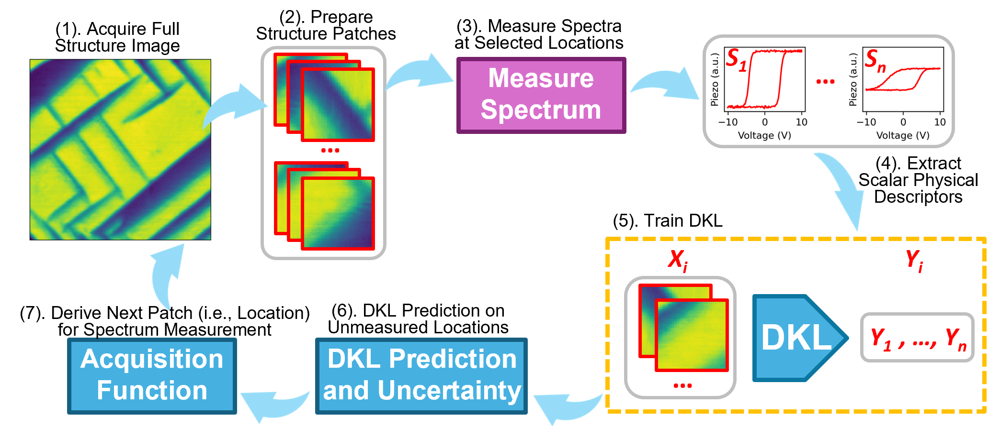

### **Application**
* DKL-driven microscopy for scientific discovery can be seen through its application in [ferroelectric polarization study](https://www.nature.com/articles/s42256-022-00460-0), [non-linear behavior investigation](https://onlinelibrary.wiley.com/doi/full/10.1002/smll.202204130), and [halide perovskites](https://pubs.acs.org/doi/full/10.1021/acs.jpclett.3c00223).

### **Further developments**
* DKL can also be combined with other ML methods such as reinforcement learning to further enhance its capability, see [example](https://www.nature.com/articles/s41524-023-00985-x)
* We also offer an example of integerating human knowledge and interest into DKL-driven autonomous experiment, see [example 1](https://arxiv.org/abs/2408.02071) and [example 2](https://arxiv.org/abs/2409.12295)

## Installation and import

In [ ]:
!pip install -q gpax
!pip install -q atomai
!pip install --upgrade gdown
!pip install pyro5
!pip install scifireaders
!pip install sidpy
!pip install pynsid
!pip install git+https://github.com/pycroscopy/DTMicroscope.git

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.4/103.4 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 373.9/373.9 kB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 351.1/351.1 kB 21.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 kB 7.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.6/162.6 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 277.8/277.8 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.4/176.4 kB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 27.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.1/79.1 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.2/84.2 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.4/102.4 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 63.7 MB/s eta 0:00:00
   ━━

In [ ]:
from warnings import filterwarnings

import numpy as np
import matplotlib.pyplot as plt
import math
import os
import Pyro5.api
from IPython.display import clear_output, display
from sklearn.model_selection import train_test_split

import gpax
from atomai.utils import get_coord_grid, extract_patches_and_spectra, extract_subimages

gpax.utils.enable_x64()
filterwarnings("ignore", module="haiku._src.data_structures")

In [ ]:
!run_server_afm

You don't have igor2 installed.     If you wish to open igor files, you will need to install it     (pip install igor2) before attempting.
You don't have gwyfile installed.     If you wish to open .gwy files, you will need to      install it (pip install gwyfile) before attempting.
Server started and running in the background. Logs are being written to server.log.


## Load a pre-acquired PS data to simulate a microscopy experiment

Download PS data:

In [ ]:
!wget -O "PTO_BEPS_1um.h5" https://www.dropbox.com/scl/fi/dwpyy2jzalcriqhza7i0c/pto_beps_1um.h5?rlkey=wg08auuxzd47fbzpx7wag5j6j&dl=1

--2024-11-19 20:48:31--  https://www.dropbox.com/scl/fi/dwpyy2jzalcriqhza7i0c/pto_beps_1um.h5?rlkey=wg08auuxzd47fbzpx7wag5j6j
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.18, 2620:100:6025:18::a27d:4512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://uc2af15eaa826cacea2a15503f46.dl.dropboxusercontent.com/cd/0/inline/CesJcfXjSkLb0lkSHRJ2EBZwkk515JA0Fd0L5QlI0O8rTs_9HGSOur4VY614Du4k2njtJZjwxWo8ojEbKgR1ZQu5XNklwRPtou-wv1QMkqZ1k09GYuA6Gqyn0kBAPBjMVFYx_s5JKVwI_OABiW5REdYx/file# [following]
--2024-11-19 20:48:33--  https://uc2af15eaa826cacea2a15503f46.dl.dropboxusercontent.com/cd/0/inline/CesJcfXjSkLb0lkSHRJ2EBZwkk515JA0Fd0L5QlI0O8rTs_9HGSOur4VY614Du4k2njtJZjwxWo8ojEbKgR1ZQu5XNklwRPtou-wv1QMkqZ1k09GYuA6Gqyn0kBAPBjMVFYx_s5JKVwI_OABiW5REdYx/file
Resolving uc2af15eaa826cacea2a15503f46.dl.dropboxusercontent.com (uc2af15eaa826cacea2a15503f46.dl.dropboxusercontent.com)... 162.125.65.15,

Load the data:

In [ ]:
import SciFiReaders as sr
nsid_reader = sr.NSIDReader('PTO_BEPS_1um.h5')
datasets = nsid_reader.read()

You don't have igor2 installed.     If you wish to open igor files, you will need to install it     (pip install igor2) before attempting.
You don't have gwyfile installed.     If you wish to open .gwy files, you will need to      install it (pip install gwyfile) before attempting.


In [ ]:
datasets

{'Channel_000': sidpy.Dataset of type IMAGE with:
  dask.array<array, shape=(50, 50), dtype=float64, chunksize=(50, 50), chunktype=numpy.ndarray>
  data contains: Piezoresponse (a.u.)
  and Dimensions: 
 x:  Length (um) of size (50,)
 y:  Length (um) of size (50,),
 'Channel_001': sidpy.Dataset of type POINT_CLOUD with:
  dask.array<array, shape=(2500, 256), dtype=float64, chunksize=(2500, 256), chunktype=numpy.ndarray>
  data contains: Piezoresponse (a.u.)
  and Dimensions: 
 point number:  Point number (generic) of size (2500,)
 Voltage:  Voltage (V) of size (256,)}

In [ ]:
%matplotlib widget
from google.colab import output
output.enable_custom_widget_manager()

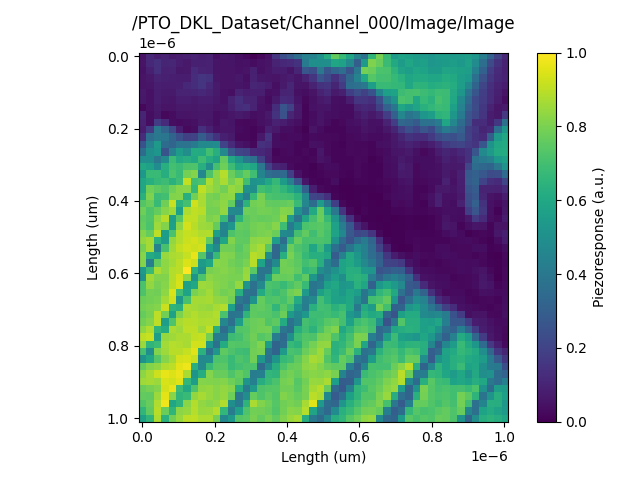

In [ ]:
#TODO: Fix the point cloud viewer scaling for the spectra.

view0 = datasets['Channel_000'].plot();


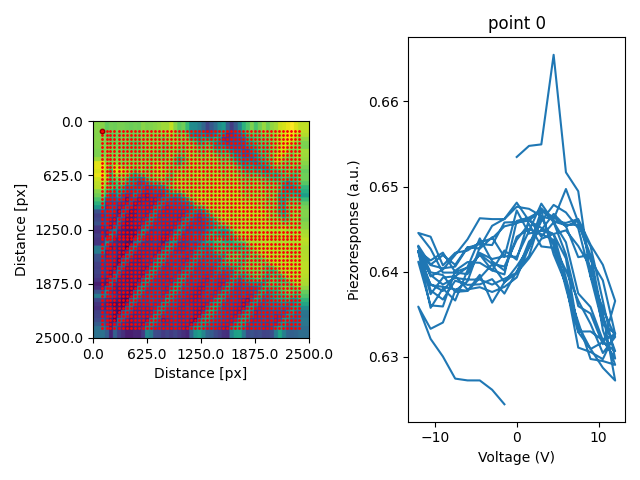

In [ ]:
view1 = datasets['Channel_001'].plot();

Plot a couple of points on top of the original image

Text(0, 0.5, 'Piezoresponse (a.u.)')

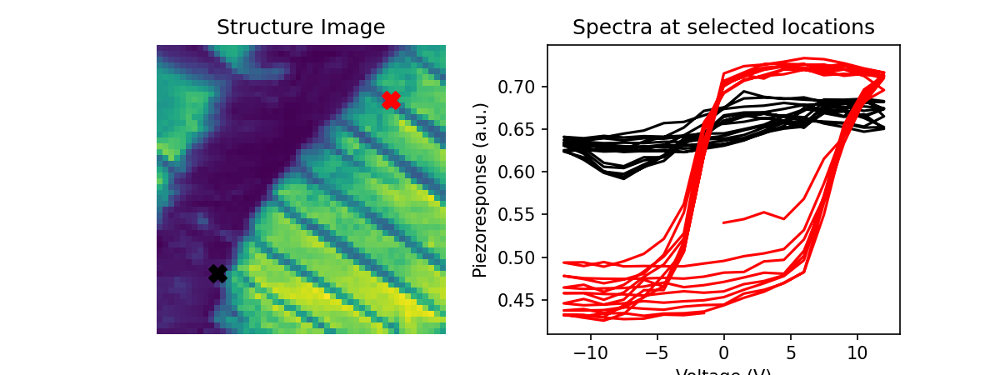

In [ ]:
image = np.array(datasets['Channel_000'])
spectra = np.array(datasets['Channel_001']).reshape(50,50,-1)
v_step = datasets['Channel_001']._axes[1].values

spec_pixel_x1 = 10; spec_pixel_y1 = 10
spec_pixel_x2 = 40; spec_pixel_y2 = 40
# Plot image and spectra at selected locations
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 3), dpi = 150)

ax1.imshow(image, origin = "lower")
ax1.scatter(spec_pixel_x1, spec_pixel_y1, marker='X', s=100, c='k')
ax1.scatter(spec_pixel_x2, spec_pixel_y2, marker='X', s=100, c='r')
ax1.set_title('Structure Image')
ax1.axis("off")

ax2.set_title("Spectra at selected locations")
ax2.plot(v_step, spectra[spec_pixel_x1, spec_pixel_y1], c = 'k')
ax2.plot(v_step, spectra[spec_pixel_x2, spec_pixel_y2], c = 'r')
ax2.set_xlabel('Voltage (V)')
ax2.set_ylabel('Piezoresponse (a.u.)')

⚡ ⚡ ⚡ ⚡ ⚡ ⚡ ⚡

***Note: This dataset includes an image showing nanoscale structures and spectra for all locations. However, in a real microscopy experiment, spectra are only available at the measured locations. Therefore, in the simulated experiment, DKL will only have access to the image and the spectra at the selected (i.e., measured) locations.***

## Deep Kernel Learning

✅ It will be easier to understand DKL-experiment by following the workflows of DKL-driven microscopy at the beginning of this notebook

Data preprocessing for DKL

In [ ]:
# Prepare image patches that show local structures
coordinates = get_coord_grid(image, step = 1, return_dict=False)

# extract image patch for each point on a grid
window_size = 16
features_all, coords, _ = extract_subimages(image, coordinates, window_size)
features = features_all[:,:,:,0]

indices_all = np.array(coords, dtype = int)

print(features.shape)

(1225, 16, 16)


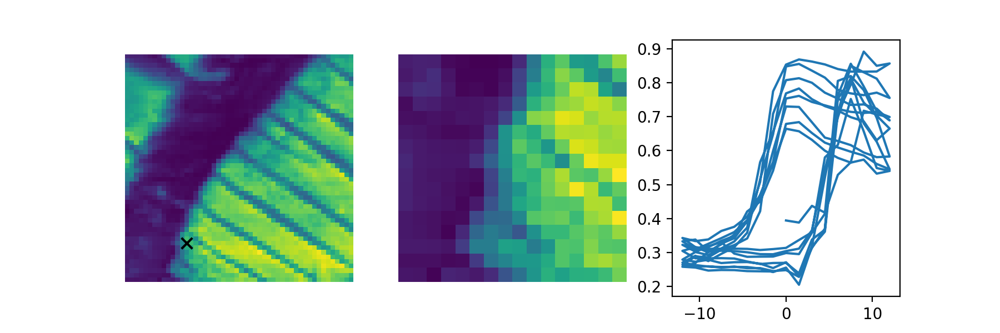

In [ ]:
#Plot an example patch and spectrum
k = 5

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(9, 3), dpi =200)
ax1.imshow(image, origin = 'lower')
ax1.scatter(indices_all[k, 1], indices_all[k, 0], marker='x', s=50, c='k')

ax1.axis("off")
ax2.imshow(features[k], origin = 'lower')
ax2.axis("off")
ax3.plot(v_step, spectra[indices_all[k, 0], indices_all[k, 1]])

Normalize data:

In [ ]:
norm_ = lambda x: (x - x.min()) / x.ptp()
features = norm_(features)

### DKL-driven microscopy experiment
Now we are going to use DKL to actively learn the relationship between local structures and their corresponding physical behavior or property, Trained DKL can make prediction for the physical property over the entire image (including unmeasured locations). We can use the prediction and uncertainty to compute acquisition function for sampling the next measurement point.

Next, we define a scalarizer function that will convert a measured spectrum into a scalar physical descriptor.

In this PS dataset, we use a scalar function that calculates the hysteresis loop area. In SNVM experiment, we need to define a different scalar function that extracts physical descriptor from SNVM spectroscopy data.

In [ ]:
nsid_reader._h5_file.close()

In [ ]:
#the first step here is to register the data to the microscope
uri = "PYRO:microscope.server@localhost:9092" #port for the AFM DT 9092
mic_server = Pyro5.api.Proxy(uri)
import sys

mic_server.initialize_microscope("AFM", data_path = r"PTO_BEPS_1um.h5")

mic_server.setup_microscope(data_source = 'Compound_Dataset_1')
mic_server.get_dataset_info()

[('channels', ['Channel_000', 'Channel_001']),
 ('signals', ['Piezoresponse', 'Piezoresponse']),
 ('units', ['a.u.', 'a.u.']),
 ('scans', [0]),
 ('spectra', []),
 ('point_clouds', [1])]

In [ ]:
# here the scalar function is to calculate the hysteresis loop area
def loop_area (raw_spec, cycle) :
  raw_spec_len = len(raw_spec)
  cycle_len = int(raw_spec_len / cycle)
  half_len = int(cycle_len / 2)
  q_len = int(cycle_len / 4)
  loop_top, loop_bottom = [], []
  loop_top.append(raw_spec[q_len : q_len + half_len])
  loop_top.append(raw_spec[q_len + 2*half_len : q_len + 3*half_len])
  loop_top.append(raw_spec[q_len + 4*half_len : 2*q_len + 4*half_len])
  loop_bottom.append(raw_spec[:q_len])
  loop_bottom.append(raw_spec[q_len + half_len: q_len + 2*half_len])
  loop_bottom.append(raw_spec[q_len + 3*half_len: q_len + 4*half_len])
  loop_top = np.concatenate(loop_top)
  loop_bottom = np.concatenate(loop_bottom)
  return np.abs(np.sum(loop_top)-np.sum(loop_bottom))

Also define a function to plot DKL sampling results (this is optional)

In [ ]:
def plot_result(indices, obj):
    plt.figure(figsize = (4, 4))
    plt.scatter(indices[:, 1], indices[:, 0], s=10, c=obj)
    next_point = indices[obj.argmax()]
    plt.scatter(next_point[1], next_point[0], s=10, marker='x', c='k')
    plt.xticks([])
    plt.yticks([])
    plt.title("Acquisition Values")
    plt.show()

define a function to convert coordinates in image to locations in microscopy measurement

In [ ]:
def convert_coordinates_to_locations(coordinates=None, image_size_x = 1e-6, image_size_y = 1e-6,
                                     num_pix_x=50, num_pix_y=50):
    """
    Converts coordinates in image to probe location in microscopy.

    Args:
        coordinates (numpy.ndarray): Array representing the original coordinates in a 2D image.
        image_size_x (float): image size in x-direction.
        image_size_y (float): image size in y-direction.
        num_pix_x (int): Number of pixels in the X-direction.
        num_pix_y (int): Number of pixels in the Y-direction.

    Returns:
        numpy.ndarray: Array representing the converted parameters of locations.

    Notes:
        - The original coordinates should be a numpy array of shape [2] with the first element representing X-coordinate
            and the second element representing Y-coordinate.
    """

    original_coordinates = np.asarray(coordinates, dtype = np.float64()) # convert to int to float first

    coor_x = original_coordinates [:,0]
    coor_y = original_coordinates [:,1]

    # convert x and y
    loc_x = coor_x * image_size_x / num_pix_x
    loc_y = coor_y * image_size_y / num_pix_y

    # write converted locations
    converted_locations = np.copy(original_coordinates)
    converted_locations[:,0] = loc_x
    converted_locations[:,1] = loc_y

    return converted_locations


Set some parameters, convert data... for DKL

In [ ]:
n, d1, d2 = features.shape
struc_imgs = features.reshape(n, d1*d2)
data_dim = struc_imgs.shape[-1]

struc_imgs.shape

(1225, 256)

In [ ]:
#print current probe position
print(f'Current location: {mic_server.x, mic_server.y}')

Current location: (5.10204081632653e-07, 5.10204081632653e-07)


At the beginning, we need to perform spectroscopy measurements at some locations (either random or defined by operator) to start training DKL. Here let us just perform spectroscopy at some random locations.

In [ ]:
#  initial measurement points
init_size = 3   # number of spectroscopy measurements at the beginning

# select the random locations and corresponding structure image, indices, etc.
(measured_struc, unmeasured_struc, indices_measured, indices_unmeasured) = train_test_split(
      struc_imgs, indices_all, test_size=1-init_size/len(struc_imgs), shuffle=True, random_state=10)

len(measured_struc)

3

In [ ]:
# convert the coordinates in image to locations in microscopy measurement
locations_measured = convert_coordinates_to_locations(indices_measured)
locations_measured

array([[8.0e-07, 7.0e-07],
       [4.6e-07, 2.0e-07],
       [8.0e-07, 7.4e-07]])

Now we are going to 'do' spectroscopy measurements at selected locations

Do spectroscopy at [7e-07,8e-07]
Do spectroscopy at [2e-07,4.6e-07]
Do spectroscopy at [7.4e-07,8e-07]


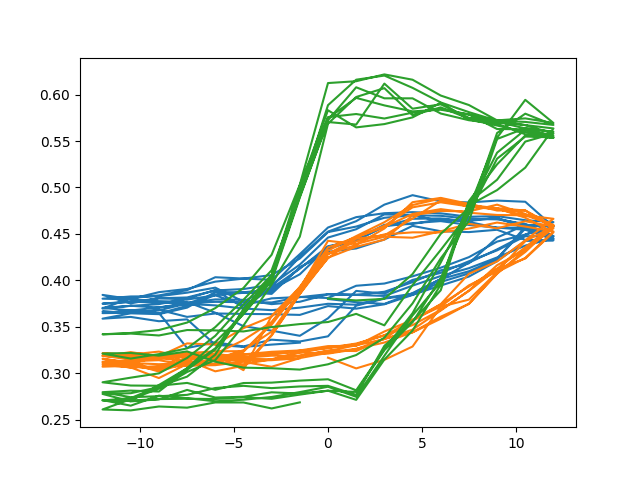

In [ ]:
#############******************************************Start**********************************###############
#############***In real experiments, this part will be replaced by spepctroscopy acquistion***###############
#  initial measurement points
init_size = 3   # number of spectroscopy measurements at the beginning
measured_spec = []
measured_spec_scalar = []
#to perform spectroscopy we can use
plt.figure()
for ind in range(init_size):
  py,px = locations_measured[ind]
  mic_server.go_to(px, py)
  print ("Do spectroscopy at [{},{}]".format(px, py))
  (spec_x, shape_spec_x, dtype_spec_x), (spec_y, shape_spec_y, dtype_spec_y) = mic_server.get_spectrum()  # Do spectrum
  _spec_x = np.array(spec_x, dtype=dtype_spec_x).reshape(shape_spec_x)
  _spec_y = np.array(spec_y, dtype=dtype_spec_y).reshape(shape_spec_y)
  measured_spec.append(_spec_y)
  measuring_spec_scalar = loop_area(_spec_y, 8)               # Convert spectrum to scalar physical descriptor
  measured_spec_scalar.append(measuring_spec_scalar)

  plt.plot(_spec_x, _spec_y)
#############***************************************************************************###############
#############***************************************************************************###############


(-0.5, 49.5, -0.5, 49.5)

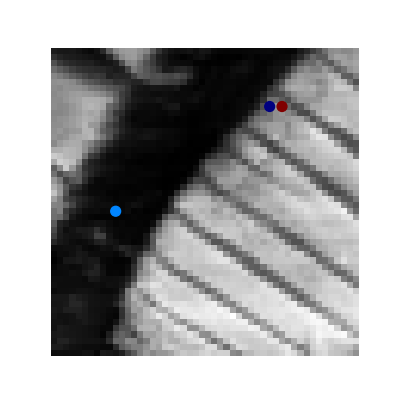

In [ ]:
# we can plot the measured locations and corresponding scalar descriptor

plt.figure(figsize=(4, 4))
plt.imshow(image, origin = "lower", cmap = "gray")
plt.scatter(indices_measured[:, 1], indices_measured[:, 0], s = 50, c=measured_spec_scalar, cmap = "jet")
plt.axis("off")

Now we are going to do DKL-driven exploration

1/50


100%|██████████| 200/200 [00:02<00:00, 86.68it/s, init loss: 20122.0759, avg. loss [191-200]: 19061.6122] 



Inferred GP kernel parameters
k_length         [0.4044 0.3709]
k_scale          0.3035
noise            0.3466


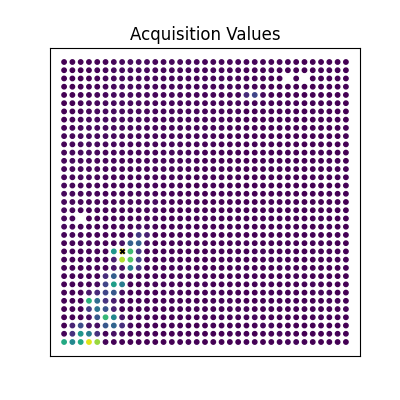

Do spectroscopy at [3e-07,3.7999999999999996e-07]
2/50


100%|██████████| 200/200 [00:01<00:00, 128.71it/s, init loss: 20123.4146, avg. loss [191-200]: 19062.0735]



Inferred GP kernel parameters
k_length         [0.4038 0.3705]
k_scale          0.31570000000000004
noise            0.2998


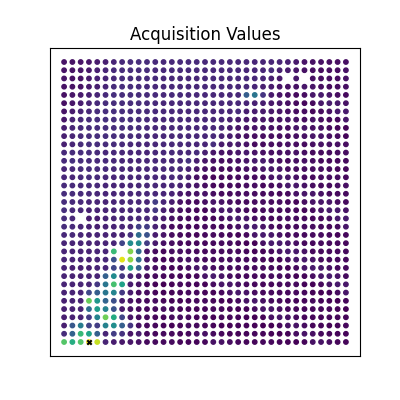

Do spectroscopy at [2.1999999999999998e-07,1.6e-07]
3/50


100%|██████████| 200/200 [00:02<00:00, 87.17it/s, init loss: 20124.6656, avg. loss [191-200]: 19062.6484] 



Inferred GP kernel parameters
k_length         [0.4027 0.3705]
k_scale          0.299
noise            0.2882


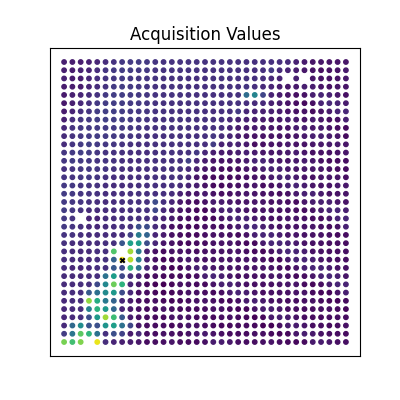

Do spectroscopy at [3e-07,3.6e-07]
4/50


100%|██████████| 200/200 [00:01<00:00, 125.74it/s, init loss: 20125.9131, avg. loss [191-200]: 19063.0259]



Inferred GP kernel parameters
k_length         [0.4022 0.3702]
k_scale          0.2913
noise            0.27030000000000004


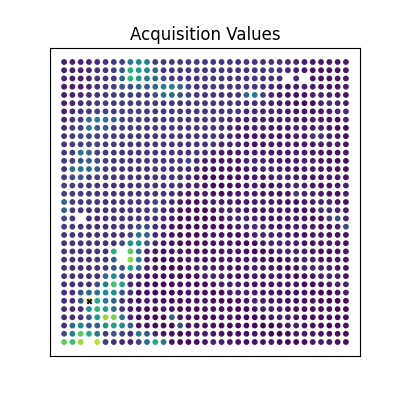

Do spectroscopy at [2.1999999999999998e-07,2.6e-07]
5/50


100%|██████████| 200/200 [00:01<00:00, 124.53it/s, init loss: 20127.1090, avg. loss [191-200]: 19063.3182]



Inferred GP kernel parameters
k_length         [0.4017 0.3701]
k_scale          0.2878
noise            0.2543


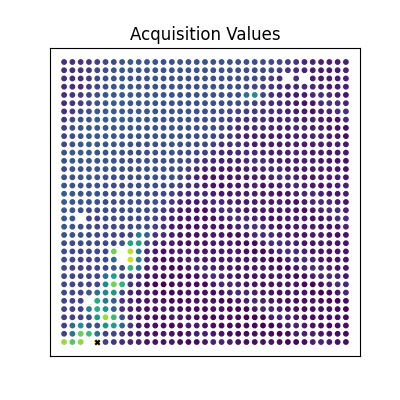

Do spectroscopy at [2.4000000000000003e-07,1.6e-07]
6/50


100%|██████████| 200/200 [00:01<00:00, 121.62it/s, init loss: 20128.3440, avg. loss [191-200]: 19063.7069]



Inferred GP kernel parameters
k_length         [0.4016 0.3696]
k_scale          0.28240000000000004
noise            0.2467


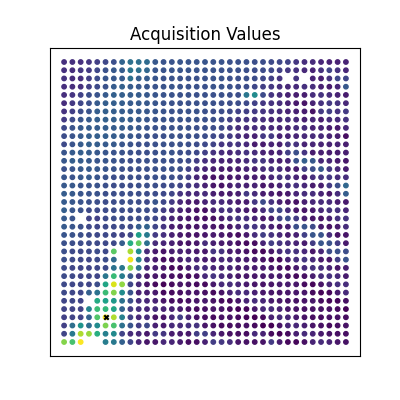

Do spectroscopy at [2.6e-07,2.1999999999999998e-07]
7/50


100%|██████████| 200/200 [00:01<00:00, 119.82it/s, init loss: 20129.5181, avg. loss [191-200]: 19063.9935]



Inferred GP kernel parameters
k_length         [0.4017 0.3694]
k_scale          0.2793
noise            0.2384


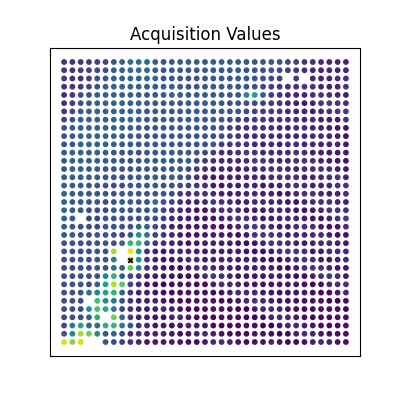

Do spectroscopy at [3.2e-07,3.6e-07]
8/50


100%|██████████| 200/200 [00:01<00:00, 119.35it/s, init loss: 20130.7578, avg. loss [191-200]: 19064.3022]



Inferred GP kernel parameters
k_length         [0.4003 0.3692]
k_scale          0.2768
noise            0.23220000000000002


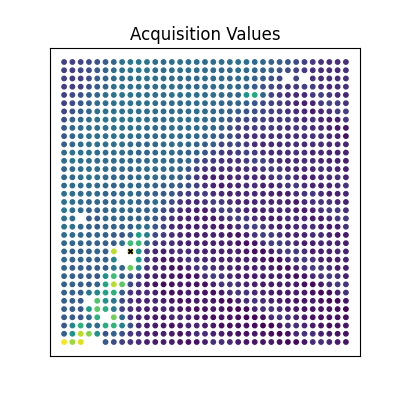

Do spectroscopy at [3.2e-07,3.7999999999999996e-07]
9/50


100%|██████████| 200/200 [00:01<00:00, 124.12it/s, init loss: 20132.0519, avg. loss [191-200]: 19064.7023]



Inferred GP kernel parameters
k_length         [0.399  0.3688]
k_scale          0.2808
noise            0.2286


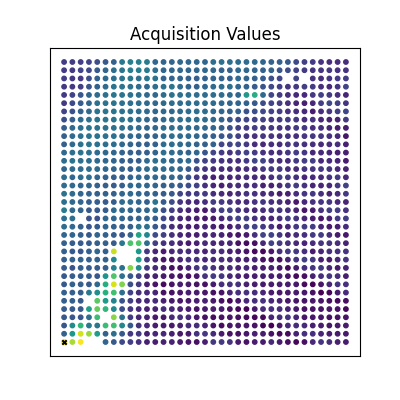

Do spectroscopy at [1.6e-07,1.6e-07]
10/50


100%|██████████| 200/200 [00:01<00:00, 115.52it/s, init loss: 20133.2946, avg. loss [191-200]: 19064.9907]



Inferred GP kernel parameters
k_length         [0.3982 0.3689]
k_scale          0.2795
noise            0.2243


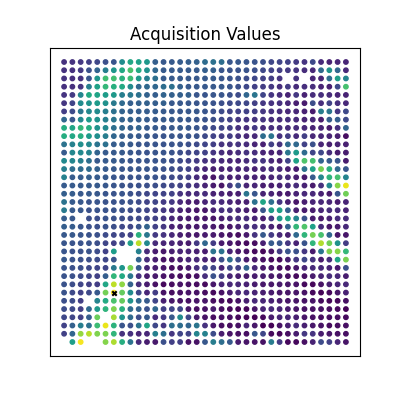

Do spectroscopy at [2.8e-07,2.8e-07]
11/50


100%|██████████| 200/200 [00:01<00:00, 122.84it/s, init loss: 20134.4666, avg. loss [191-200]: 19065.1819]



Inferred GP kernel parameters
k_length         [0.3976 0.3686]
k_scale          0.2786
noise            0.2195


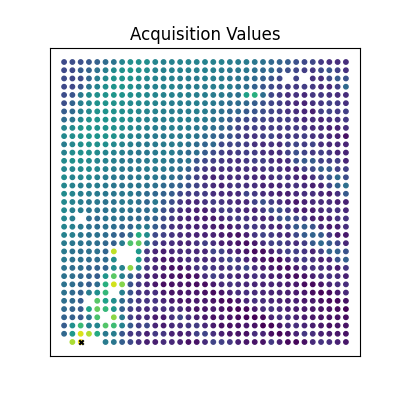

Do spectroscopy at [2e-07,1.6e-07]
12/50


100%|██████████| 200/200 [00:02<00:00, 95.96it/s, init loss: 20135.6575, avg. loss [191-200]: 19065.4380] 



Inferred GP kernel parameters
k_length         [0.3958 0.3685]
k_scale          0.2773
noise            0.2165


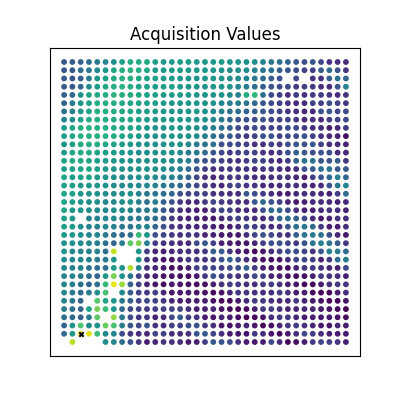

Do spectroscopy at [2e-07,1.8e-07]
13/50


100%|██████████| 200/200 [00:01<00:00, 119.64it/s, init loss: 20136.8110, avg. loss [191-200]: 19065.6227]



Inferred GP kernel parameters
k_length         [0.3957 0.3684]
k_scale          0.2762
noise            0.21330000000000002


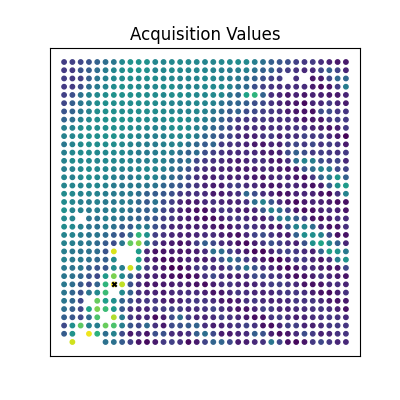

Do spectroscopy at [2.8e-07,3e-07]
14/50


100%|██████████| 200/200 [00:01<00:00, 114.98it/s, init loss: 20138.0010, avg. loss [191-200]: 19065.8044]



Inferred GP kernel parameters
k_length         [0.3946 0.3683]
k_scale          0.278
noise            0.2101


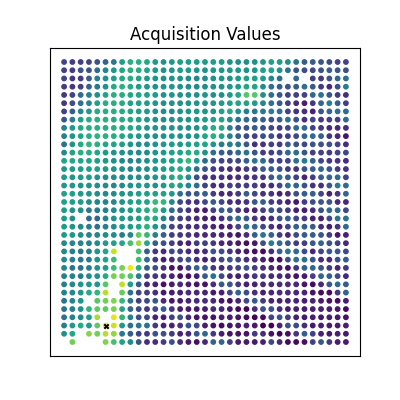

Do spectroscopy at [2.6e-07,2e-07]
15/50


100%|██████████| 200/200 [00:01<00:00, 106.56it/s, init loss: 20139.1888, avg. loss [191-200]: 19065.1953]



Inferred GP kernel parameters
k_length         [0.3925 0.2998]
k_scale          0.3229
noise            0.1897


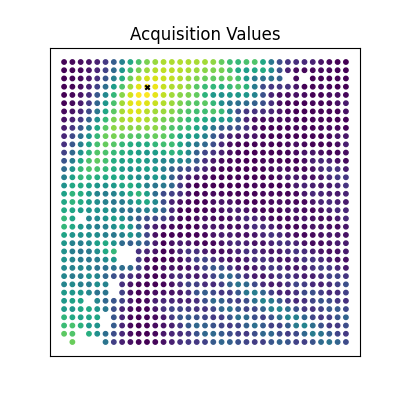

Do spectroscopy at [3.6e-07,7.799999999999999e-07]
16/50


100%|██████████| 200/200 [00:01<00:00, 109.22it/s, init loss: 20140.4372, avg. loss [191-200]: 19065.2904]



Inferred GP kernel parameters
k_length         [0.3932 0.304 ]
k_scale          0.3259
noise            0.187


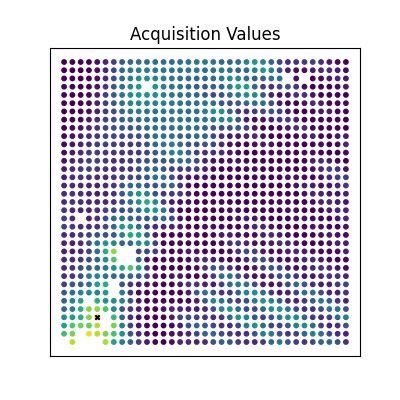

Do spectroscopy at [2.4000000000000003e-07,2.1999999999999998e-07]
17/50


100%|██████████| 200/200 [00:01<00:00, 107.51it/s, init loss: 20141.6296, avg. loss [191-200]: 19065.4271]



Inferred GP kernel parameters
k_length         [0.3932 0.297 ]
k_scale          0.3264
noise            0.1864


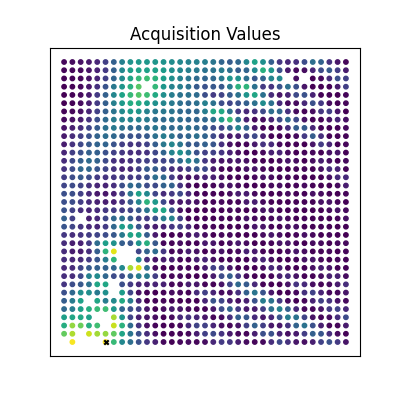

Do spectroscopy at [2.6e-07,1.6e-07]
18/50


100%|██████████| 200/200 [00:03<00:00, 65.29it/s, init loss: 20142.8258, avg. loss [191-200]: 19065.4792] 



Inferred GP kernel parameters
k_length         [0.3902 0.2968]
k_scale          0.3267
noise            0.185


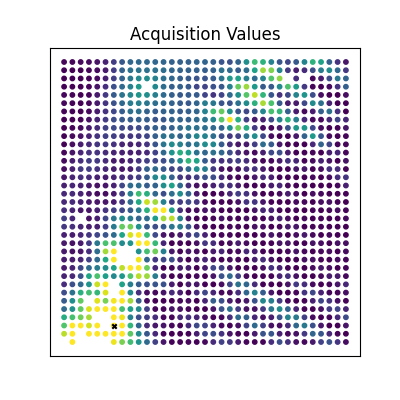

Do spectroscopy at [2.8e-07,2e-07]
19/50


100%|██████████| 200/200 [00:01<00:00, 103.49it/s, init loss: 20144.0444, avg. loss [191-200]: 19065.7053]



Inferred GP kernel parameters
k_length         [0.3881 0.2976]
k_scale          0.3244
noise            0.1845


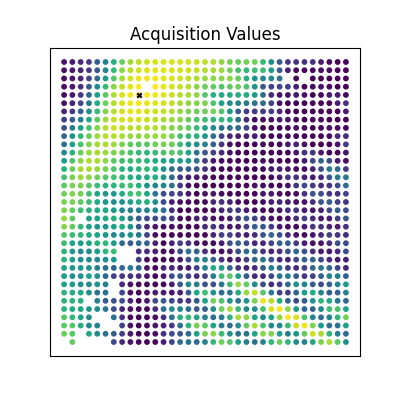

Do spectroscopy at [3.4e-07,7.599999999999999e-07]
20/50


100%|██████████| 200/200 [00:01<00:00, 103.67it/s, init loss: 20145.2783, avg. loss [191-200]: 19066.0517]



Inferred GP kernel parameters
k_length         [0.3872 0.3066]
k_scale          0.31720000000000004
noise            0.18580000000000002


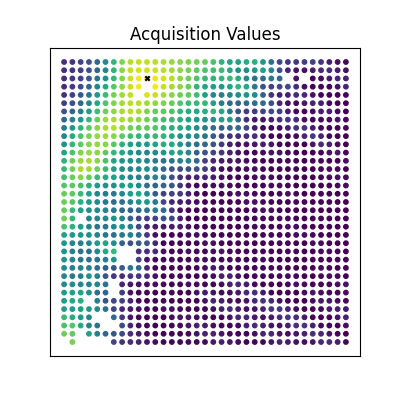

Do spectroscopy at [3.6e-07,8e-07]
21/50


100%|██████████| 200/200 [00:01<00:00, 103.80it/s, init loss: 20146.4668, avg. loss [191-200]: 19066.6294]



Inferred GP kernel parameters
k_length         [0.3861 0.33  ]
k_scale          0.3064
noise            0.18810000000000002


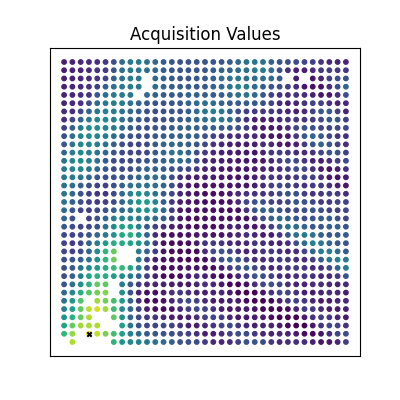

Do spectroscopy at [2.1999999999999998e-07,1.8e-07]
22/50


100%|██████████| 200/200 [00:01<00:00, 106.28it/s, init loss: 20147.6389, avg. loss [191-200]: 19066.0449]



Inferred GP kernel parameters
k_length         [0.386  0.3104]
k_scale          0.323
noise            0.1825


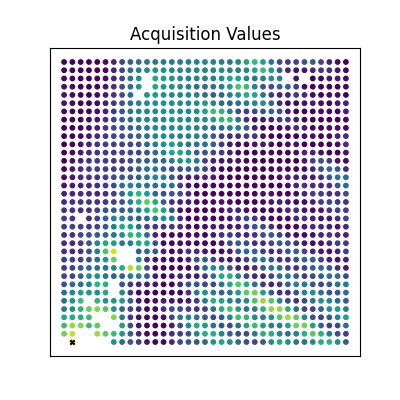

Do spectroscopy at [1.8e-07,1.6e-07]
23/50


100%|██████████| 200/200 [00:01<00:00, 103.15it/s, init loss: 20148.7896, avg. loss [191-200]: 19066.2040]



Inferred GP kernel parameters
k_length         [0.3854 0.3093]
k_scale          0.32170000000000004
noise            0.1816


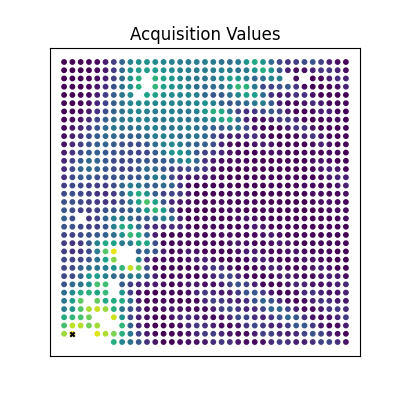

Do spectroscopy at [1.8e-07,1.8e-07]
24/50


100%|██████████| 200/200 [00:02<00:00, 96.94it/s, init loss: 20149.9139, avg. loss [191-200]: 19066.8951] 



Inferred GP kernel parameters
k_length         [0.3829 0.3156]
k_scale          0.3134
noise            0.18330000000000002


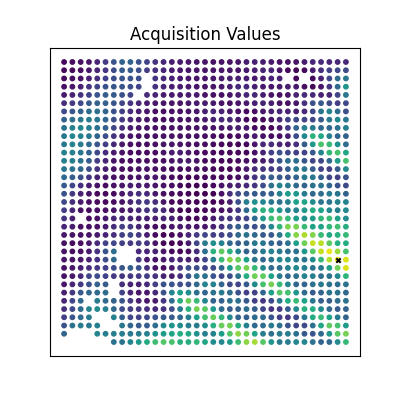

Do spectroscopy at [8.2e-07,3.6e-07]
25/50


100%|██████████| 200/200 [00:02<00:00, 98.34it/s, init loss: 20151.1605, avg. loss [191-200]: 19066.5184] 



Inferred GP kernel parameters
k_length         [0.3847 0.3091]
k_scale          0.32230000000000003
noise            0.18030000000000002


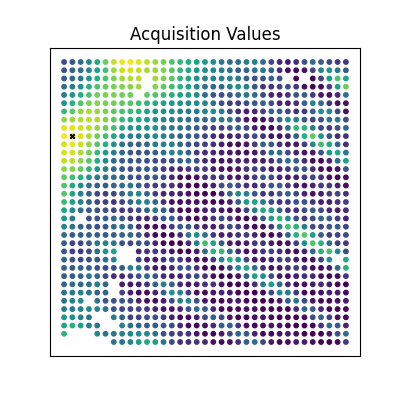

Do spectroscopy at [1.8e-07,6.599999999999999e-07]
26/50


100%|██████████| 200/200 [00:02<00:00, 99.06it/s, init loss: 20152.4299, avg. loss [191-200]: 19067.2792] 



Inferred GP kernel parameters
k_length         [0.3847 0.3668]
k_scale          0.2984
noise            0.1865


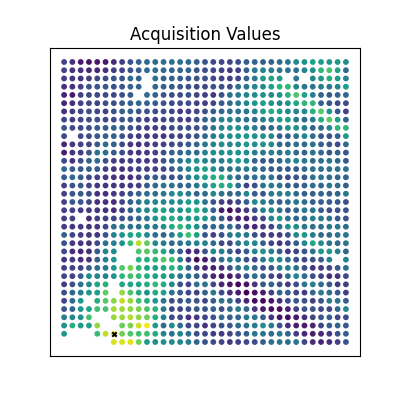

Do spectroscopy at [2.8e-07,1.8e-07]
27/50


100%|██████████| 200/200 [00:02<00:00, 98.00it/s, init loss: 20153.5637, avg. loss [191-200]: 19066.6595] 



Inferred GP kernel parameters
k_length         [0.3843 0.3109]
k_scale          0.3241
noise            0.17850000000000002


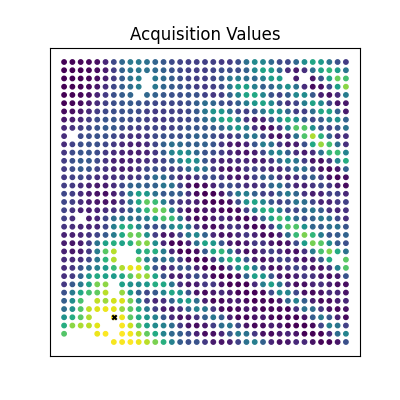

Do spectroscopy at [2.8e-07,2.1999999999999998e-07]
28/50


100%|██████████| 200/200 [00:02<00:00, 94.89it/s, init loss: 20154.7060, avg. loss [191-200]: 19066.8784] 



Inferred GP kernel parameters
k_length         [0.3811 0.3171]
k_scale          0.32320000000000004
noise            0.17800000000000002


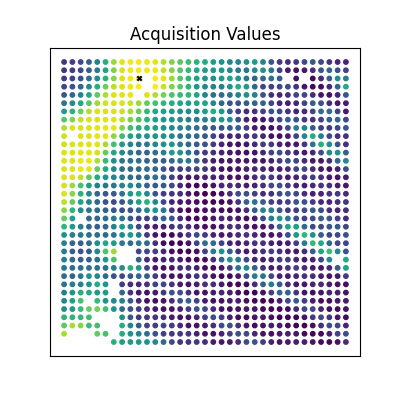

Do spectroscopy at [3.4e-07,8e-07]
29/50


100%|██████████| 200/200 [00:02<00:00, 72.29it/s, init loss: 20155.8810, avg. loss [191-200]: 19067.2324] 



Inferred GP kernel parameters
k_length         [0.3803 0.315 ]
k_scale          0.3235
noise            0.1778


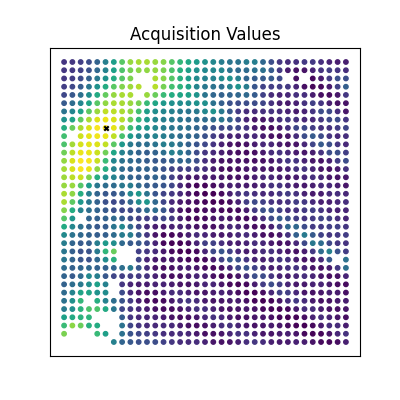

Do spectroscopy at [2.6e-07,6.8e-07]
30/50


100%|██████████| 200/200 [00:02<00:00, 74.46it/s, init loss: 20157.1280, avg. loss [191-200]: 19067.8921] 



Inferred GP kernel parameters
k_length         [0.3796 0.3642]
k_scale          0.30460000000000004
noise            0.1839


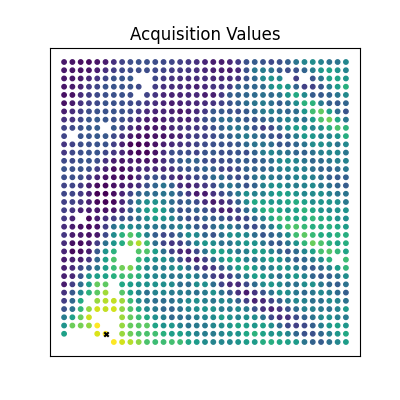

Do spectroscopy at [2.6e-07,1.8e-07]
31/50


100%|██████████| 200/200 [00:02<00:00, 97.42it/s, init loss: 20158.3280, avg. loss [191-200]: 19067.6267] 



Inferred GP kernel parameters
k_length         [0.3766 0.3236]
k_scale          0.3245
noise            0.1773


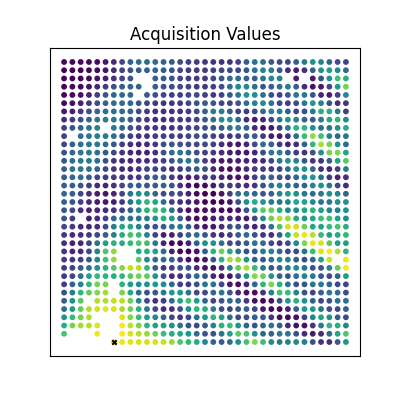

Do spectroscopy at [2.8e-07,1.6e-07]
32/50


100%|██████████| 200/200 [00:02<00:00, 82.77it/s, init loss: 20159.4777, avg. loss [191-200]: 19068.1414] 



Inferred GP kernel parameters
k_length         [0.3767 0.3668]
k_scale          0.3025
noise            0.1835


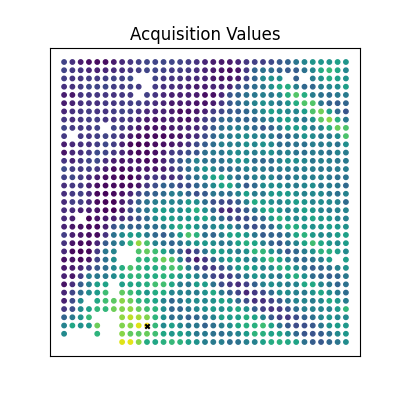

Do spectroscopy at [3.6e-07,2e-07]
33/50


100%|██████████| 200/200 [00:02<00:00, 93.55it/s, init loss: 20160.6313, avg. loss [191-200]: 19067.8143] 



Inferred GP kernel parameters
k_length         [0.377  0.3191]
k_scale          0.3235
noise            0.17700000000000002


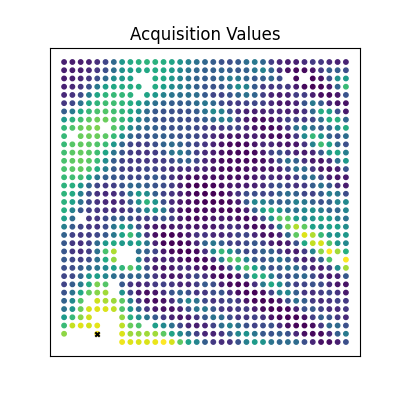

Do spectroscopy at [2.4000000000000003e-07,1.8e-07]
34/50


100%|██████████| 200/200 [00:02<00:00, 76.22it/s, init loss: 20161.7686, avg. loss [191-200]: 19068.3093] 



Inferred GP kernel parameters
k_length         [0.3687 0.3355]
k_scale          0.3116
noise            0.1801


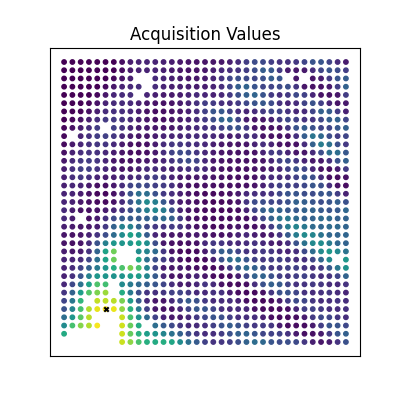

Do spectroscopy at [2.6e-07,2.4000000000000003e-07]
35/50


100%|██████████| 200/200 [00:02<00:00, 91.32it/s, init loss: 20162.8839, avg. loss [191-200]: 19068.4293] 



Inferred GP kernel parameters
k_length         [0.3748 0.3411]
k_scale          0.3098
noise            0.1796


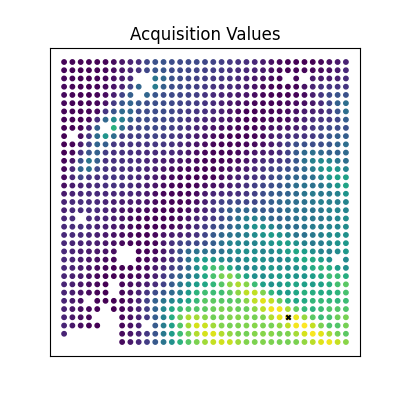

Do spectroscopy at [7e-07,2.1999999999999998e-07]
36/50


100%|██████████| 200/200 [00:02<00:00, 83.47it/s, init loss: 20164.0903, avg. loss [191-200]: 19068.0901] 



Inferred GP kernel parameters
k_length         [0.3756 0.3273]
k_scale          0.3171
noise            0.1771


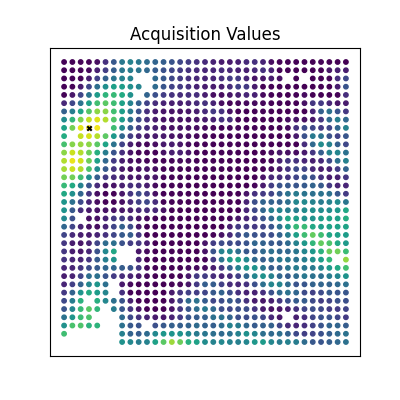

Do spectroscopy at [2.1999999999999998e-07,6.8e-07]
37/50


100%|██████████| 200/200 [00:02<00:00, 90.16it/s, init loss: 20165.3985, avg. loss [191-200]: 19068.4181] 



Inferred GP kernel parameters
k_length         [0.3752 0.3331]
k_scale          0.3194
noise            0.1764


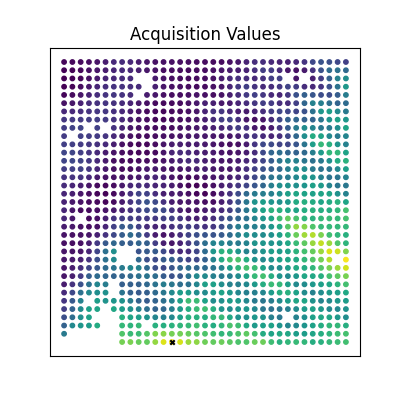

Do spectroscopy at [4.2e-07,1.6e-07]
38/50


100%|██████████| 200/200 [00:02<00:00, 70.39it/s, init loss: 20166.6535, avg. loss [191-200]: 19068.3651] 



Inferred GP kernel parameters
k_length         [0.3716 0.3376]
k_scale          0.3221
noise            0.1757


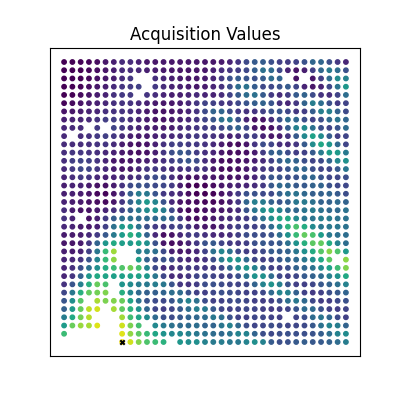

Do spectroscopy at [3e-07,1.6e-07]
39/50


100%|██████████| 200/200 [00:02<00:00, 92.20it/s, init loss: 20167.8660, avg. loss [191-200]: 19068.6706] 



Inferred GP kernel parameters
k_length         [0.3732 0.3363]
k_scale          0.32080000000000003
noise            0.1766


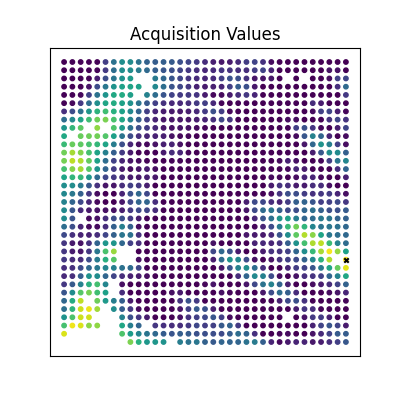

Do spectroscopy at [8.4e-07,3.6e-07]
40/50


100%|██████████| 200/200 [00:02<00:00, 88.67it/s, init loss: 20169.1061, avg. loss [191-200]: 19068.8056] 



Inferred GP kernel parameters
k_length         [0.3718 0.3492]
k_scale          0.322
noise            0.1759


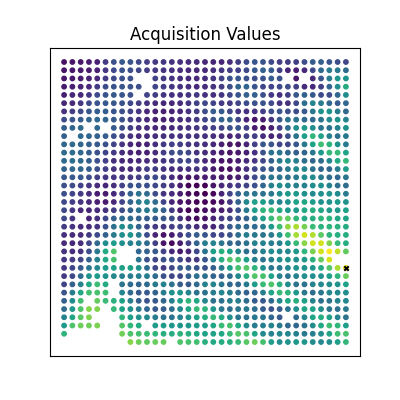

Do spectroscopy at [8.4e-07,3.4e-07]
41/50


100%|██████████| 200/200 [00:02<00:00, 92.51it/s, init loss: 20170.3439, avg. loss [191-200]: 19068.6674] 



Inferred GP kernel parameters
k_length         [0.3709 0.3393]
k_scale          0.3262
noise            0.1746


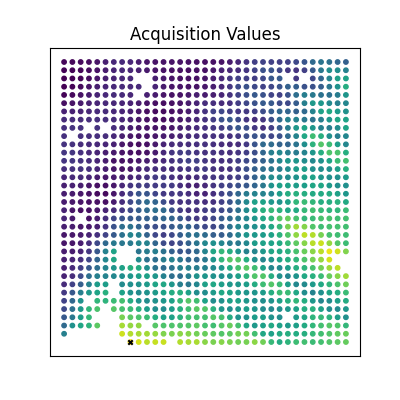

Do spectroscopy at [3.2e-07,1.6e-07]
42/50


100%|██████████| 200/200 [00:02<00:00, 77.27it/s, init loss: 20171.5812, avg. loss [191-200]: 19068.7159] 



Inferred GP kernel parameters
k_length         [0.3697 0.3367]
k_scale          0.3275
noise            0.17420000000000002


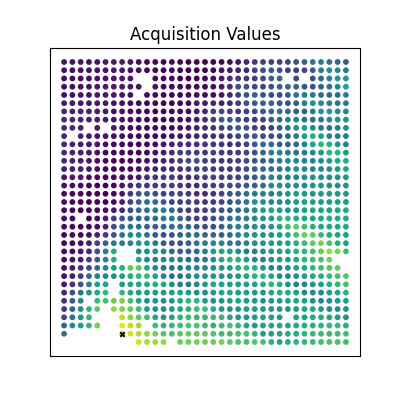

Do spectroscopy at [3e-07,1.8e-07]
43/50


100%|██████████| 200/200 [00:02<00:00, 93.20it/s, init loss: 20172.7272, avg. loss [191-200]: 19068.9142] 



Inferred GP kernel parameters
k_length         [0.3717 0.3514]
k_scale          0.3246
noise            0.17420000000000002


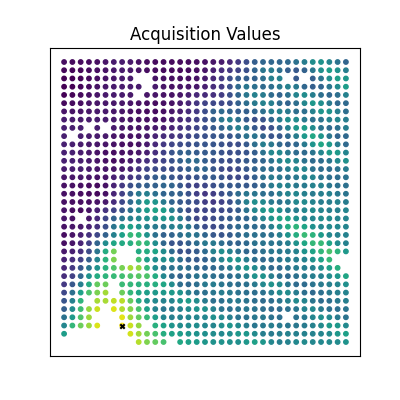

Do spectroscopy at [3e-07,2e-07]
44/50


100%|██████████| 200/200 [00:02<00:00, 81.70it/s, init loss: 20173.8524, avg. loss [191-200]: 19069.2633] 



Inferred GP kernel parameters
k_length         [0.3719 0.3559]
k_scale          0.3236
noise            0.17470000000000002


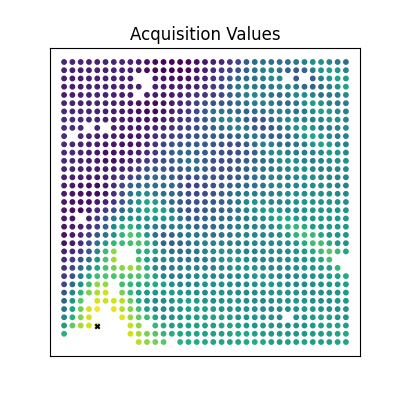

Do spectroscopy at [2.4000000000000003e-07,2e-07]
45/50


100%|██████████| 200/200 [00:02<00:00, 94.31it/s, init loss: 20174.9678, avg. loss [191-200]: 19068.7932] 



Inferred GP kernel parameters
k_length         [0.3726 0.3401]
k_scale          0.3285
noise            0.1734


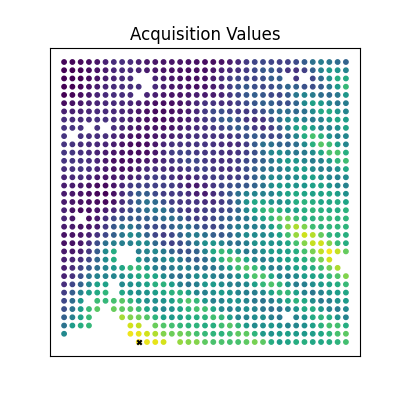

Do spectroscopy at [3.4e-07,1.6e-07]
46/50


100%|██████████| 200/200 [00:02<00:00, 83.68it/s, init loss: 20176.1285, avg. loss [191-200]: 19069.3042] 



Inferred GP kernel parameters
k_length         [0.3726 0.352 ]
k_scale          0.32580000000000003
noise            0.17370000000000002


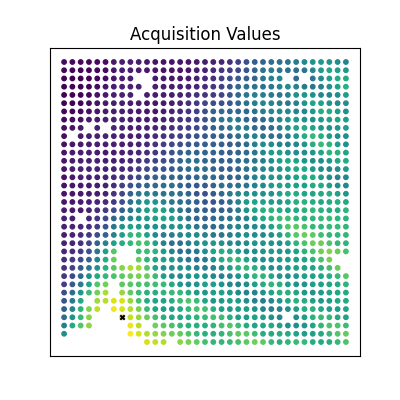

Do spectroscopy at [3e-07,2.1999999999999998e-07]
47/50


100%|██████████| 200/200 [00:02<00:00, 92.59it/s, init loss: 20177.2616, avg. loss [191-200]: 19068.9591] 



Inferred GP kernel parameters
k_length         [0.3732 0.3389]
k_scale          0.327
noise            0.17320000000000002


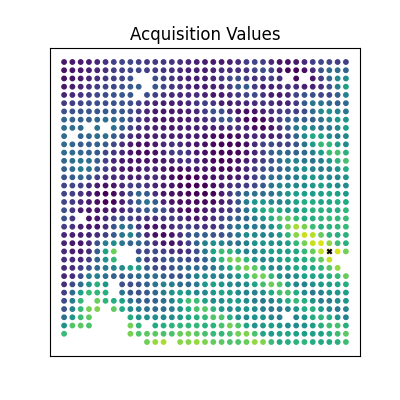

Do spectroscopy at [8e-07,3.7999999999999996e-07]
48/50


100%|██████████| 200/200 [00:02<00:00, 69.25it/s, init loss: 20178.4933, avg. loss [191-200]: 19069.0469] 



Inferred GP kernel parameters
k_length         [0.3778 0.3405]
k_scale          0.3284
noise            0.1733


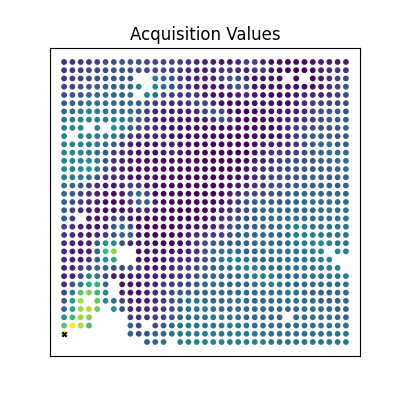

Do spectroscopy at [1.6e-07,1.8e-07]
49/50


100%|██████████| 200/200 [00:02<00:00, 90.33it/s, init loss: 20179.6746, avg. loss [191-200]: 19069.6149] 



Inferred GP kernel parameters
k_length         [0.3759 0.3404]
k_scale          0.3292
noise            0.1738


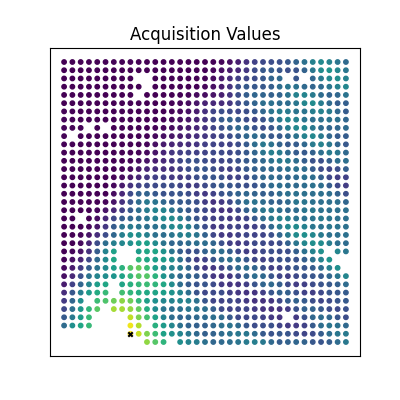

Do spectroscopy at [3.2e-07,1.8e-07]
50/50


100%|██████████| 200/200 [00:03<00:00, 63.31it/s, init loss: 20180.8651, avg. loss [191-200]: 19069.8150] 



Inferred GP kernel parameters
k_length         [0.3786 0.3491]
k_scale          0.3259
noise            0.17450000000000002


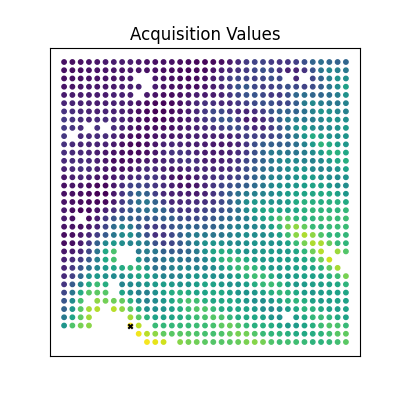

Do spectroscopy at [3.2e-07,2e-07]


In [ ]:
exploration_steps = 50  # iterations we want to explore

key1, key2 = gpax.utils.get_keys()
for e in range(exploration_steps):
    print("{}/{}".format(e+1, exploration_steps))

    ##########----Start-DKL training, predition, and sampling-----##########
    dkl = gpax.viDKL(data_dim, 2)
    dkl.fit(key1, measured_struc, norm_(np.asarray(measured_spec_scalar)), num_steps=200, step_size=0.01)
    obj = gpax.acquisition.EI(key2, dkl, unmeasured_struc)
    # Select next point to "measure"
    next_point_idx = obj.argmax()
    # Plot sampling result
    plot_result(indices_unmeasured, obj)
    ##########-----End-DKL training, predition, and sampling-----##########


#############************************************Start Experiment*****************************###############
#############***In real experiments, this part will be replaced by spepctroscopy acquistion***###############
    # Do "measurement"
    next_loc = convert_coordinates_to_locations(indices_unmeasured[next_point_idx][None])
    py, px = next_loc[0][0], next_loc[0][1]
    mic_server.go_to(px, py)
    print ("Do spectroscopy at [{},{}]".format(px, py))
    (spec_x, shape_spec_x, dtype_spec_x), (spec_y, shape_spec_y, dtype_spec_y) = mic_server.get_spectrum()  # Do spectrum
    _spec_x = np.array(spec_x, dtype=dtype_spec_x).reshape(shape_spec_x)
    _spec_y = np.array(spec_y, dtype=dtype_spec_y).reshape(shape_spec_y)
    measuring_spec_scalar = loop_area(_spec_y, 8)
#############***************************************************************************###############
#############***************************************************************************###############

    # Update measured/unmeasured data
    measured_struc = np.append(measured_struc, unmeasured_struc[next_point_idx][None], 0)
    unmeasured_struc = np.delete(unmeasured_struc, next_point_idx, 0)
    measured_spec_scalar = np.append(measured_spec_scalar, measuring_spec_scalar)
    indices_measured = np.append(indices_measured, indices_unmeasured[next_point_idx][None], 0)
    indices_unmeasured = np.delete(indices_unmeasured, next_point_idx, 0)

Plot DKL sampled points and corresponding physical property

([], [])

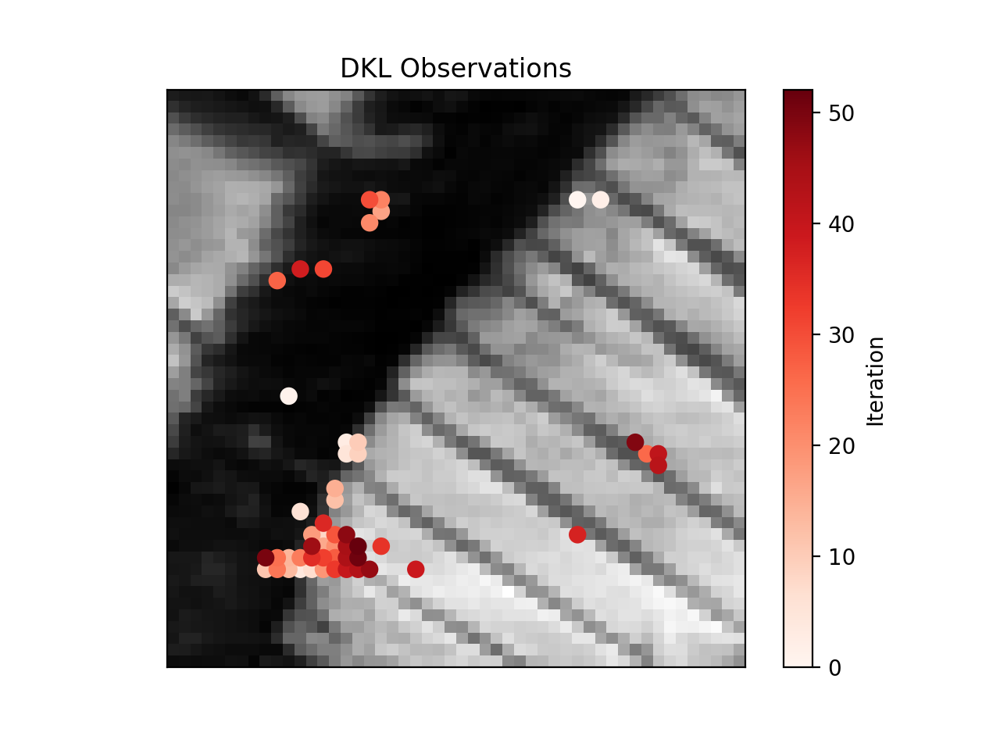

In [39]:
plt.figure(dpi = 200)
plt.imshow(image, origin="lower", cmap='gray')
plt.scatter(indices_measured[:, 1], indices_measured[:, 0],
            c=np.arange(len(indices_measured)), s=50, cmap="Reds")
plt.colorbar(label="Iteration")
plt.title("DKL Observations")
plt.xticks([])
plt.yticks([])

Trained DKL can make prediction over the entire space

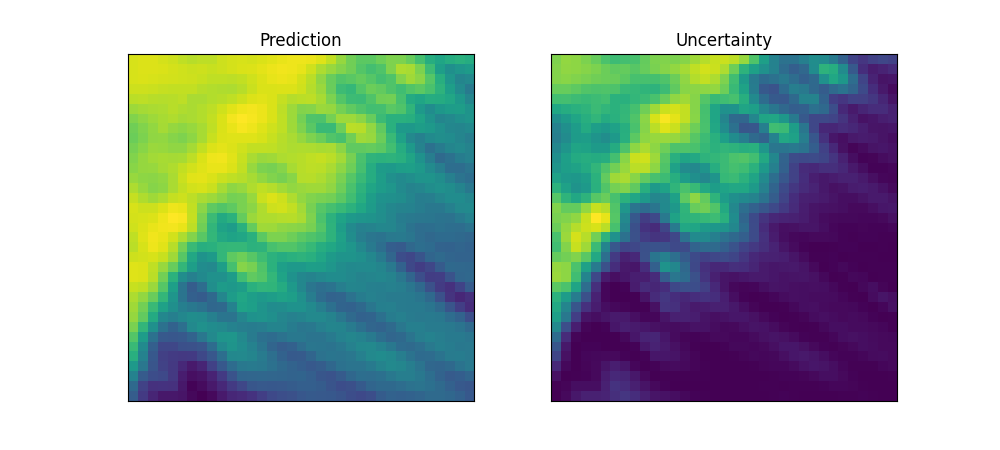

In [40]:
mean, var = dkl.predict(key2, struc_imgs)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4.5), dpi=100)
ax1.imshow(mean.reshape((35,35)), origin = 'lower')
ax1.set_title("Prediction")
ax2.imshow(var.reshape((35,35)), origin = 'lower')
ax2.set_title("Uncertainty")
for _ax in fig.axes:
    _ax.set_aspect('equal')
    _ax.set_xticks([])
    _ax.set_yticks([])